In [1]:
import math
import numpy as np
import scipy.signal as signal
import matplotlib.pyplot as plt
from scipy.signal import sosfiltfilt, butter

from intanutil.read_data import read_data

This notebook is for extracting data from the intan RHS files using the intan python packages.

#### Import Data

In [2]:
filepath = '/home/dmifsud/Projects/NAYLab/POSITI~1.RHS'
data = read_data(filepath)


# extract the raw 30kHz voltage (𝛍V) data
raw_30k_data = data['amplifier_data']

print(f'\nShape of data: {raw_30k_data.shape}')


Reading Intan Technologies RHS2000 Data File, Version 3.0

n signal groups 8
Found 32 amplifier channels.
Found 0 board ADC channels.
Found 0 board DAC channels.
Found 0 board digital input channels.
Found 0 board digital output channels.

16896 bytes per data block
File contains 60.002 seconds of data.  Amplifiers were sampled at 30.00 kS/s.

Allocating memory for data...
Reading data from file...
10% done...
20% done...
30% done...
40% done...
50% done...
60% done...
70% done...
80% done...
90% done...
Parsing data...
No missing timestamps in data.
Done!  Elapsed time: 2.4 seconds

Shape of data: (32, 1800064)


#### Visualize Raw Data

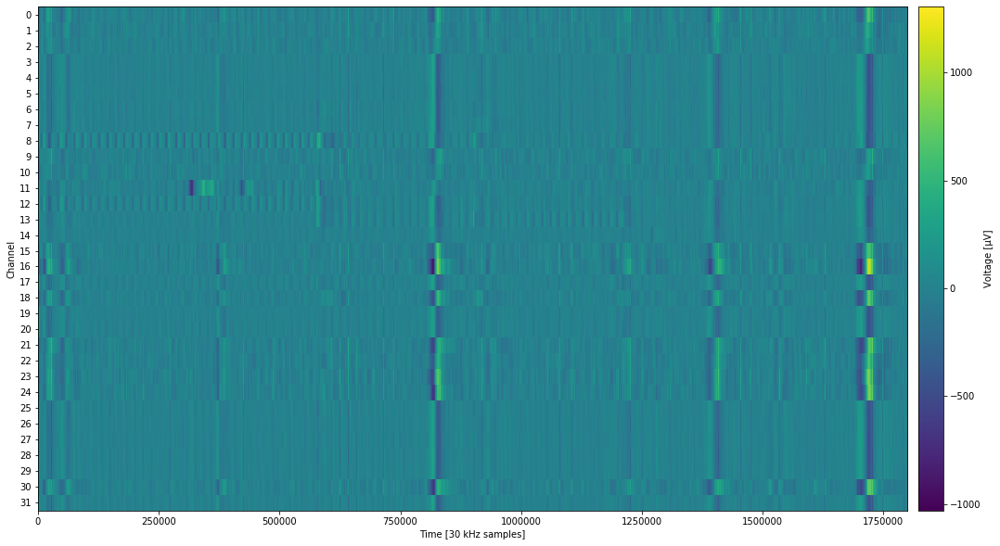

In [3]:
# examine the amplifier data for the entire recording
def plot_30k_data(data, channels=None):
    """ function to plot the raw amplifier data.
    """
    if channels is None:
        channels = np.arange(data.shape[0])
    plt.figure(figsize=(20, len(channels) * 0.3125))                            # figure size is (width, height), scale height to the number of channels
    plt.imshow(data[channels], interpolation='none', aspect='auto')             # plot the data, inshow usually smooths the data, so we turn that off and set the aspect ratio to auto
    plt.xlabel('Time [30 kHz samples]')                                         # add x-axis label
    plt.ylabel('Channel')                                                       # add y-axis label
    colorbar = plt.colorbar(pad=0.01)                                           # make the color bar close to the figure
    colorbar.set_label('Voltage [μV]')                                          # add x-axis label
    ticks = plt.yticks(np.arange(len(channels)), channels)                      # make sure we are plotting the correct channel numbers
    
plot_30k_data(raw_30k_data) 

##### Possible channels for masking / Irregularities:
[8, 11, 12, 13] - Visible osscilations at begining of recording (13 near middle, 11 only breifly at begining)

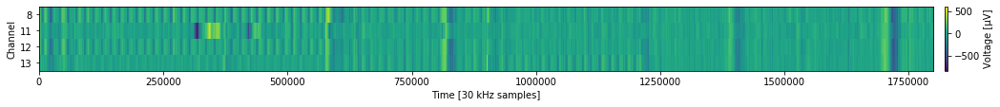

In [4]:
plot_30k_data(raw_30k_data, channels=[8, 11, 12, 13])

There appears to also be two "groups" of channels (not sure if this is shank related?). They appear to have inverted noise events (right before 1750000 one group have pos to neg and one has neg to pos) 
- [3-8, 11-14, 17, 19, 20, 25-29, 31]
- [0, 1, 2, 9, 10, 15, 16, 18, 21-24, 30]


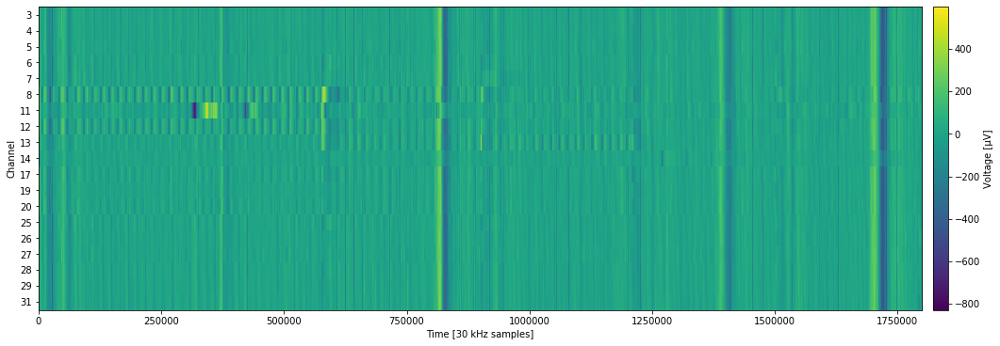

In [5]:
plot_30k_data(raw_30k_data, channels=[3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 17, 19, 20, 25, 26, 27, 28, 29, 31])

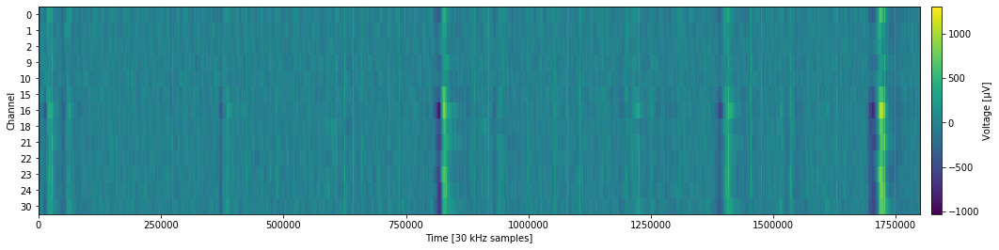

In [6]:
plot_30k_data(raw_30k_data, channels=[0, 1, 2, 9, 10, 15, 16, 18, 21, 22, 23, 24, 30])

Channels I identified as "good" when looking at the spike rasters at first glance [5, 8, 11, 12, 13] were interestingly also the channels that had those osscilations.

#### Examine Frequency content / Filter

In [7]:
# function to build a filter given a filter order, freq range, and sampling rate
def build_filter(filt_order, filt_range, fs):
    btype = 'bandpass'
    if filt_range[0] is None:
        btype = 'lowpass'
        filt_range = filt_range[1]
    elif filt_range[1] is None:
        btype = 'highpass'
        filt_range = filt_range[0]
    
    filter = butter(filt_order, filt_range, btype=btype, analog=False, output='sos', fs=fs)
    return btype, filter

# function to plot the power spectral density (PSD) of the data
def plot_psd(raw_data, filt_order=4, filt_range=(250, None), plot_ranges=None, channels=None, group_name=None):
    samp_rate = 30000                                                           # sampling rate of the amplifier in Hz, by default 30 kHz
    mask_data = raw_data[:, channels] if channels is not None else raw_data     # mask the data if channels are specified
    car_data = mask_data - np.mean(mask_data, axis=1, keepdims=True)            # common-average reference

    # Build and apply the filter
    btype, filter = build_filter(filt_order, filt_range, samp_rate)
    filt_data = signal.sosfiltfilt(filter, car_data, axis=0)                    # sos filt filt applies the filter forward and backward to remove phase shift

    # Prepare signals and labels
    signals = [raw_data, car_data, filt_data]
    labels = ['All Channels', 'Common-Average Reference', f'{filt_range} Hz {btype.capitalize()} Filter']
    if channels is not None:
        signals.insert(1, mask_data)
        labels.insert(1, 'Excluded Channels')

    # Calculate the PSD
    n_bins = samp_rate // 2 + 1
    freqs, S = [], []
    for s, l in zip(signals, labels):
        nch = s.shape[1]
        f, p = np.zeros((n_bins, nch)), np.zeros((n_bins, nch))
        for ich in range(nch):
            f[:, ich], p[:, ich] = signal.welch(s[:, ich], fs=samp_rate, nperseg=samp_rate)
        freqs.append(f)
        S.append(p)

    # Set the plot ranges
    if plot_ranges is None:
        plot_ranges = [(0, 15000), (0, 250), (250, 2000)]

    # Plot the PSD
    fig, axes = plt.subplots(len(plot_ranges), 1, figsize=(12, 4*len(plot_ranges)))
    for i, fr in enumerate(plot_ranges):
        ax = axes[i] if len(plot_ranges) > 1 else axes
        for f, p, l in zip(freqs, S, labels):
            ax.semilogy(f.mean(axis=1)[fr[0]:fr[1]], p.mean(axis=1)[fr[0]:fr[1]], label=l)
        ax.set(title=f'{fr[0]}-{fr[1]} Hz', ylabel='Mean PSD [$(\mu V)^2/{Hz}$]')
        ax.legend()

    # Add titles
    plt.xlabel('Frequency [Hz]')
    if group_name is None and channels is None:
        group_name = 'All Channels'
    elif group_name is None and channels is not None:
        raise ValueError('Must specify group name if channels are specified.')
    plt.suptitle(f'Power Spectral Density ({group_name})')

    # Adjust the layout (add room for the title)
    plt.tight_layout()
    top_value = lambda n: 1.0 - (0.01 * n**2 - 0.076 * n + 0.195) 
    plt.subplots_adjust(top=top_value(len(plot_ranges))) 

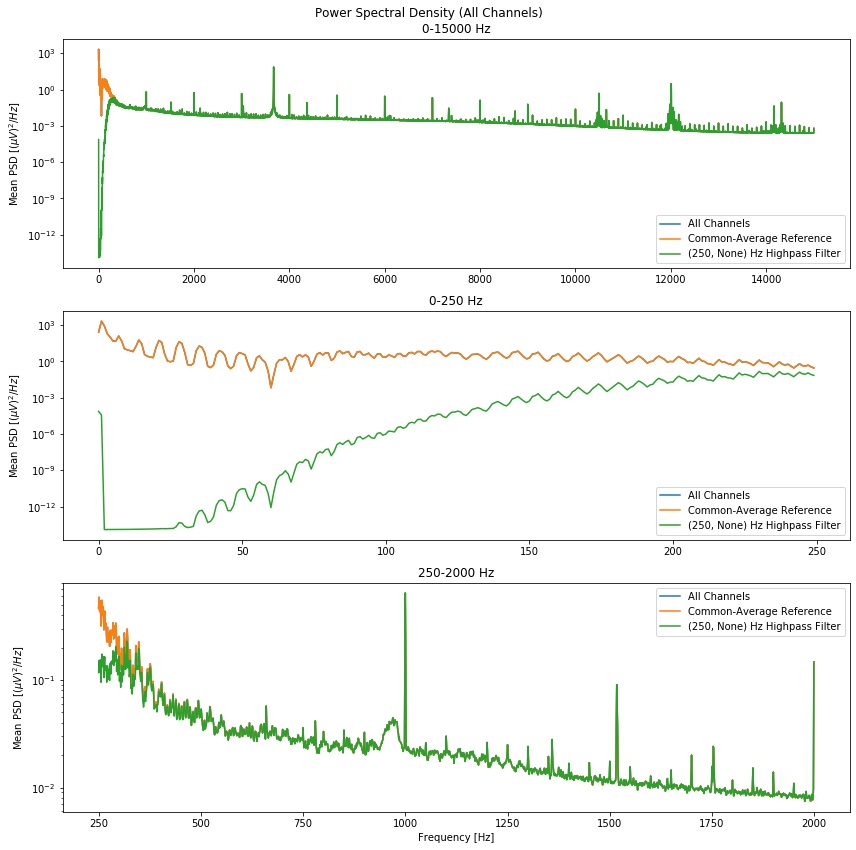

In [8]:
# plot with the same arguements used by SNEL braingate (4th order, 250 Highpass)
plot_psd(raw_30k_data.T)

Interestingly the common average reference appears to have no effect. Lets now investigate what happens with masking channels / groups of channels.

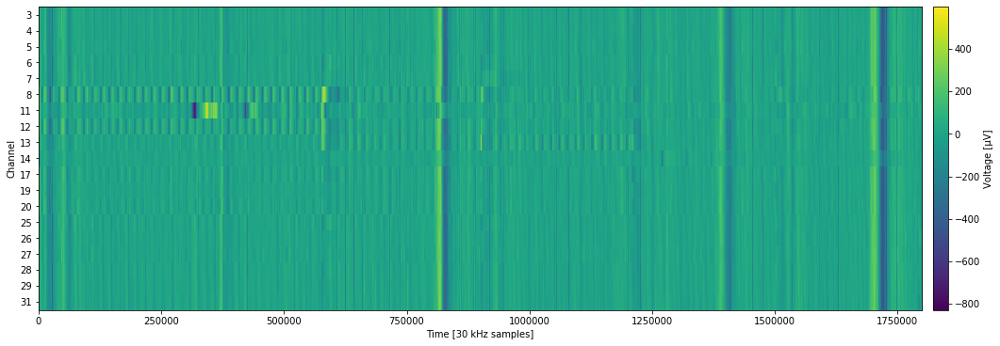

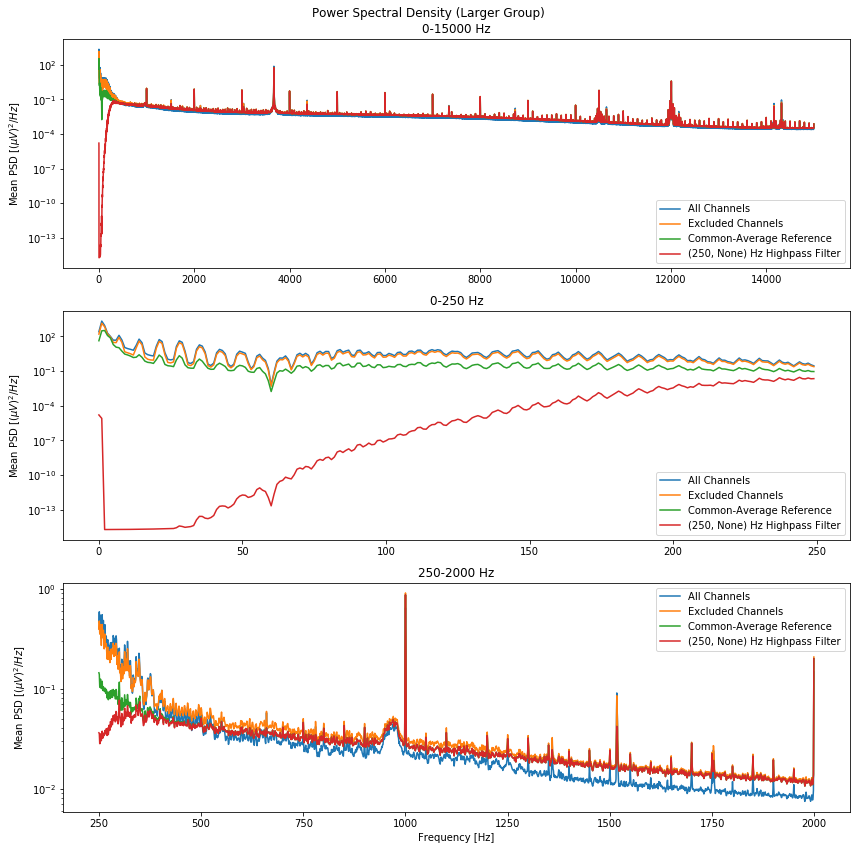

In [9]:
# Lets now run the PSD on the larger group of channels (channels plotted below)
larger_group = [3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 17, 19, 20, 25, 26, 27, 28, 29, 31]
plot_30k_data(raw_30k_data, channels=larger_group)
plot_psd(raw_30k_data.T, channels=larger_group, group_name='Larger Group')

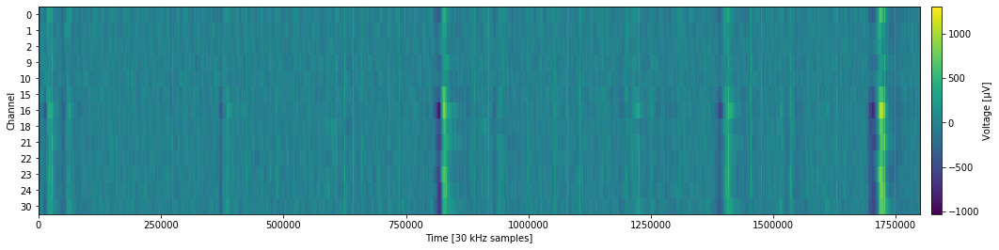

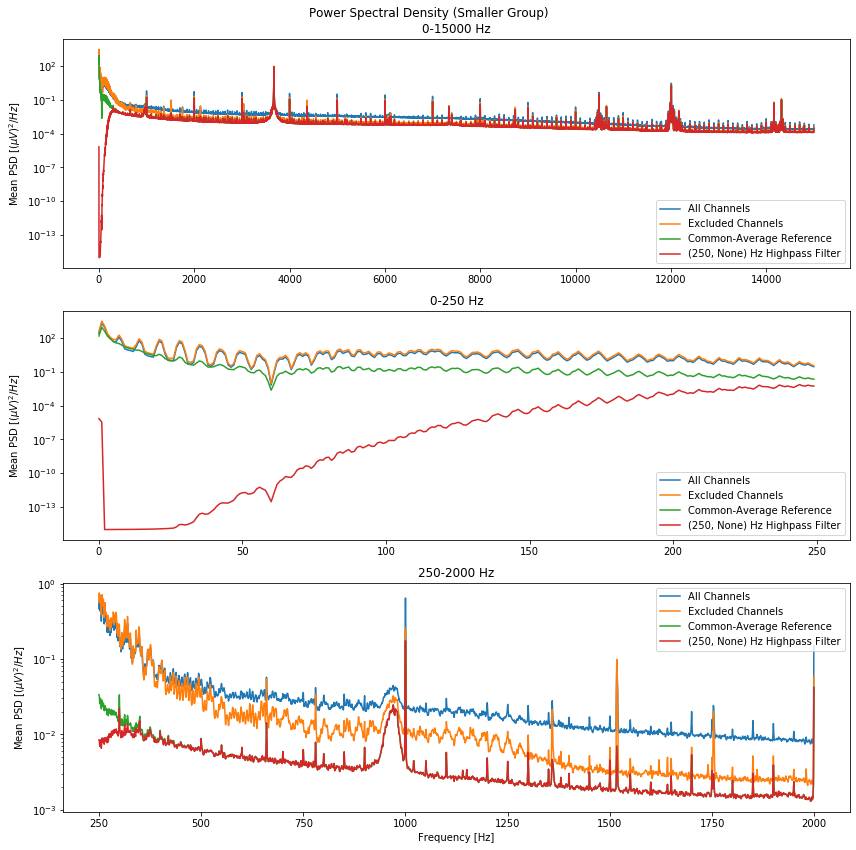

In [10]:
# Lets now run the PSD on the smaller group of channels (channels plotted below)
smaller_group = [0, 1, 2, 9, 10, 15, 16, 18, 21, 22, 23, 24, 30]
plot_30k_data(raw_30k_data, channels=smaller_group)
plot_psd(raw_30k_data.T, channels=smaller_group, group_name='Smaller Group')

It would appear that the common average reference does more when only operating on the "groups".

Lets now try different filters starting with a 250-5000 Hz Bandpass. There appears to be a very large spike just before 4 kHz so lets try filtering that out with a 250-3000 Hz Bandpass.

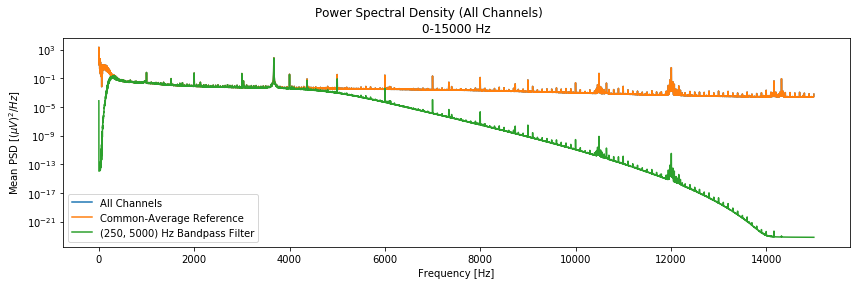

In [11]:
# Plot with 4th order, 250-5000 Hz Bandpass filter
plot_psd(raw_30k_data.T, filt_range=(250, 5000), plot_ranges=[(0, 15000)])

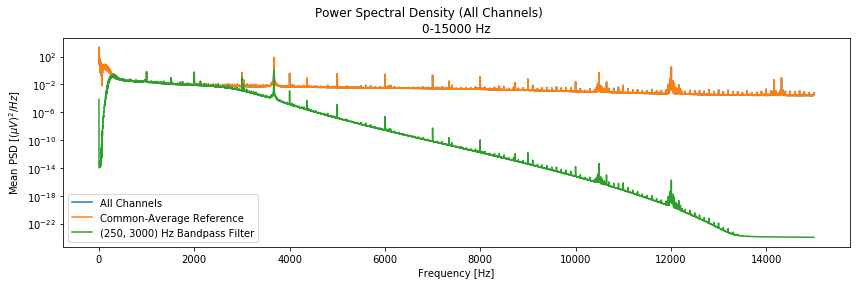

In [12]:
# Plot with 4th order, 250-3000 Hz Bandpass filter
plot_psd(raw_30k_data.T, filt_range=(250, 3000), plot_ranges=[(0, 15000)])

Not sure these plots tell me much, lets move on to actually filtering the data.

In [13]:
groups = [np.arange(32), larger_group, smaller_group]                           # groups of channels to test
filter_ranges = [(250, None), (250, 5000), (250, 3000)]                         # frequency range for the filters to test

First common average refernce the data.

In [14]:
# Common Average Reference (CAR) the groups
car_data = []
for ch_group in groups:                                                         # loop through the groups of channels and compute the common-average reference
    data = raw_30k_data[ch_group[0]:ch_group[1]].T                              # extract the data for the group of channels
    car = np.mean(data, axis=1, keepdims=True)                                  # take the mean of the channels across all timesteps
    car_data.append(raw_30k_data.T[:, ch_group] - car)                          # reference the data with the CAR

Now apply the filters to the different channel groups.

In [15]:
# Build the filters
FILTER_ORDER = 4
filters = [build_filter(FILTER_ORDER, fr, 30000) for fr in filter_ranges]       # build a filter for each frequency range

# Apply the filters
filt_data = []
for ch_gr_car in car_data:                                                      # loop through the groups of channels and apply the filters
    filt = []
    for _, filter in filters:
        filt.append(sosfiltfilt(filter, ch_gr_car, axis=0))                     # apply the filter forward and backward to remove phase shift
    filt_data.append(filt)

### Generate thresholds and find Threshold Crossings
Now get the RMS of the signals and create the thresholds for each channel.

In [16]:
THRESH_MULT = 4.5

# Calculate the threshold values
threshold_values = []
for ch_gr_filt in filt_data:                                                          # loop through the groups of channels and calculate the RMS values
    thresholds = []
    for filt in ch_gr_filt:
        thresholds.append(np.sqrt(np.mean(filt**2, axis=0)) * THRESH_MULT)                                  # calculate the RMS value
    threshold_values.append(thresholds)

Now mark where the voltage crosses the thresholds.

In [17]:
POSITIVE_CROSSINGS = False

# Calculate the threshold crossings
crossings = []
for ch_gr_filt, thresholds in zip(filt_data, threshold_values):   
    filt_cross = []                     
    for filt, threshold in zip(ch_gr_filt, thresholds):                         # loop through the groups of channels and calculate the threshold crossings
        cross = np.zeros_like(filt)
        cross_init = (filt[1:] < -threshold) & (filt[:-1] >= -threshold)        # find the negative crossings
        if POSITIVE_CROSSINGS:
            cross_init = cross_init | ((filt[1:] > threshold) & (filt[:-1] <= threshold))  # find the positive crossings
        cross[1:] = cross_init
        filt_cross.append(cross)
    crossings.append(filt_cross)

### Binning / Spikes Visualization
Now lets bin the threshold crossings.

In [18]:
# Function to bin the crossings
def bin_data(data, bin_width):
    n_samples, n_chans = data.shape
    b_samples = bin_width * (n_samples // bin_width) # samples that fit evenly into a bin
    binned_data = data[:b_samples, :].reshape(-1, bin_width, n_chans).sum(axis=1)
    return binned_data

# Bin the data
spike_data = []
for ch_gr_cross in crossings:  
    filts_binned = [] 
    for filt_cross in ch_gr_cross:
        # 30 kHz -> 1 kHz (no more than one spike per ms) -> 100 Hz (10 ms bins)
        filts_binned.append(bin_data(bin_data(filt_cross, 30) > 0, 10))
    spike_data.append(filts_binned)

Now we can look at the results with different channel exclusions and filters used.

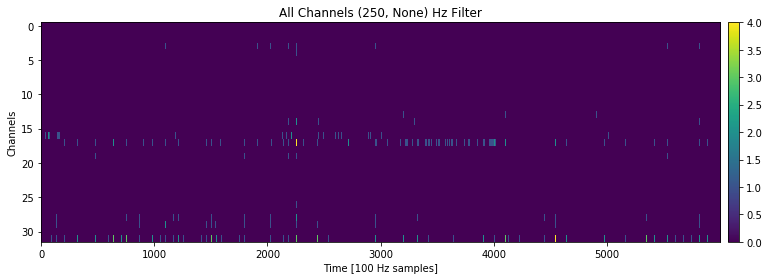

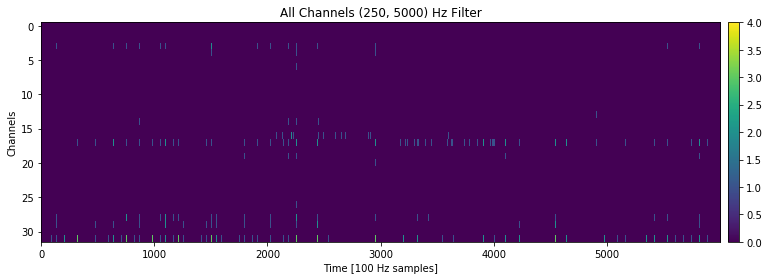

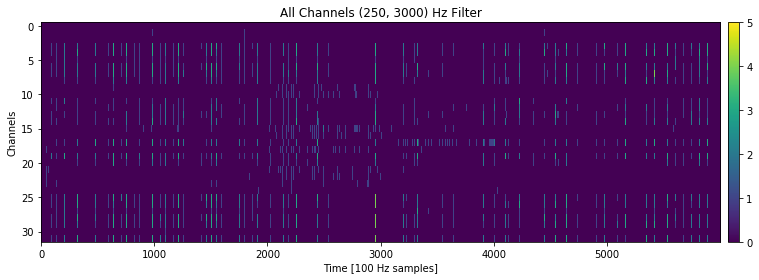

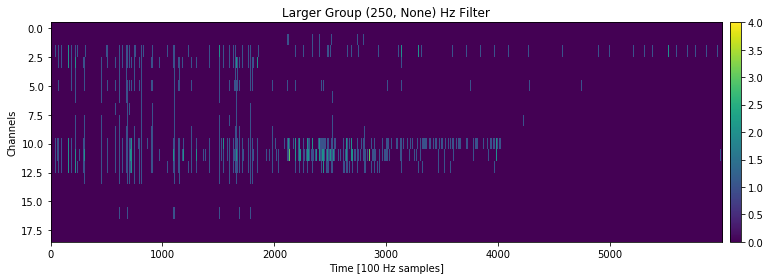

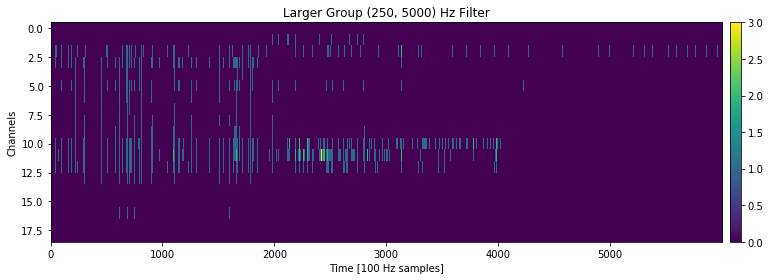

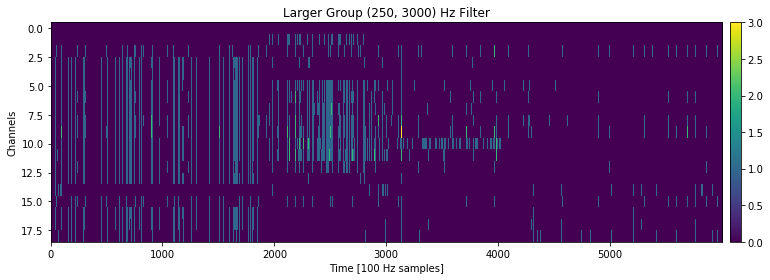

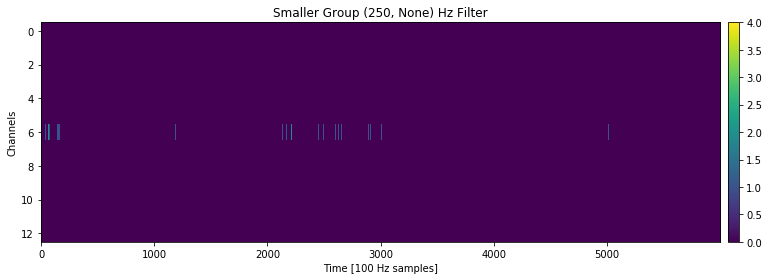

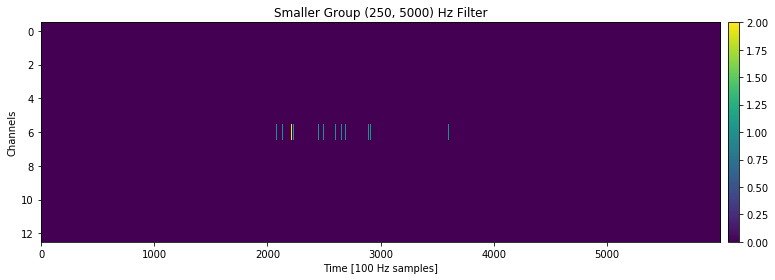

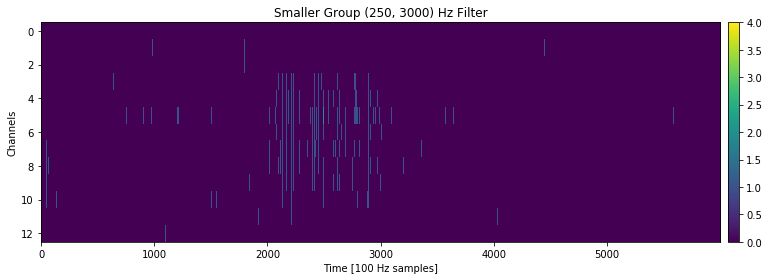

In [19]:
# Plot the spike rasters
for group_idx, group_name in enumerate(['All Channels', 'Larger Group', 'Smaller Group']):
    for filt_idx, filt_range in enumerate(filter_ranges):
        plt.figure(figsize=(12, 4))
        plt.imshow(spike_data[group_idx][filt_idx].T, aspect='auto', interpolation='none')
        plt.xlabel('Time [100 Hz samples]')
        plt.ylabel('Channels')
        plt.title(f'{group_name} {filt_range} Hz Filter')
        plt.colorbar(pad=0.01)
        plt.tight_layout()
        plt.show()

### Spike Waveforms
Now lets look at the waveforms of the spikes.

In [20]:
# function to get the int ticks for x axis
def get_tick_positions_and_labels(half_window):
    # Determine the number of ticks to the left and right of zero
    num_ticks_left = half_window // 30
    num_ticks_right = half_window // 30
    
    # Generate tick positions and labels
    tick_positions = np.concatenate([
        np.arange(-num_ticks_left * 30, 0, 30),
        np.arange(0, num_ticks_right * 30 + 1, 30)  # +1 to include the rightmost tick
    ])
    tick_labels = tick_positions // 30  # Convert sample numbers to milliseconds
    
    return tick_positions, tick_labels

# function to plot the threshold crossings
def plot_crossings(t_crossings, threshold_list, filtered_data, title, pos=True):
    # Parameters
    window_size = 160  # 40 samples before and 40 samples after the threshold crossing (assuming 30 kHz sampling rate)
    half_window = window_size // 2
    ignore_repeated_crossings = True  # Set to False to plot all crossings


    # Separate positive and negative crossings
    positive_crossings = np.zeros_like(t_crossings)
    negative_crossings = np.zeros_like(t_crossings)
    positive_crossings[1:, :] = ((filtered_data[1:, :] > threshold_list) & (filtered_data[:-1, :] <= threshold_list))
    negative_crossings[1:, :] = ((filtered_data[1:, :] < -threshold_list) & (filtered_data[:-1, :] >= -threshold_list))

    # Collect data for all channels with spikes
    data_for_plotting = []
    for ch in range(filtered_data.shape[1]):
        ch_crossings = np.argwhere(t_crossings[:, ch])[:, 0]
        ch_crossings = ch_crossings[(ch_crossings >= half_window) & (ch_crossings < filtered_data.shape[0] - half_window)]
        if len(ch_crossings) > 0:  # If there are spikes on this channel
            data_for_plotting.append((ch, ch_crossings))
    
    num_channels_with_spikes = len(data_for_plotting)
    fig, axs = plt.subplots(math.ceil(num_channels_with_spikes/2), 2, figsize=(30, len(data_for_plotting)*2))
    if num_channels_with_spikes % 2 == 1:  # If there are an odd number of subplots
        fig.delaxes(axs.flatten()[-1])
    axs = axs.flatten()  # Flatten only if there are multiple subplots
    
    for i, (ch, ch_crossings) in enumerate(data_for_plotting):
        ax = axs[i]  # Indexing or direct assignment based on subplot count
        
        # Ignore crossings within 1ms (30 samples at 30kHz) of each other if required
        if ignore_repeated_crossings and len(ch_crossings) > 0:
            binned_crossings = np.floor_divide(ch_crossings, 30)
            unique_bins, counts = np.unique(binned_crossings, return_counts=True)
            single_crossing_bins = unique_bins[counts == 1]
            ch_crossings = np.array([crossing for crossing in ch_crossings if np.floor_divide(crossing, 30) in single_crossing_bins])

        for idx in ch_crossings:
            ax.plot(np.arange(-half_window, half_window), filtered_data[idx-half_window:idx+half_window, ch])
            tick_positions, tick_labels = get_tick_positions_and_labels(half_window)
            ax.set_xticks(tick_positions)
            ax.set_xticklabels(tick_labels)
           
        if i >= len(data_for_plotting) - 2:  # Check if it's one of the bottom row plots
            ax.set_xlabel('Time relative to threshold crossing (ms)')

        ax.set_ylabel(r"Voltage ($ \mu V $)", rotation=90)

        if i % 2 == 0:  # Left column
            ax.text(-0.09, 0.5, f'Channel {ch}', transform=ax.transAxes, va='center', ha='right', fontsize=16)
        else:  # Right column
            ax.text(1.05, 0.5, f'Channel {ch}', transform=ax.transAxes, va='center', ha='left', fontsize=16)
        if pos:
            ax.axhline(y=threshold_list[ch], color='r', linestyle='--', label=f'Threshold = {threshold_list[ch]:.2f}')
            ax.axhline(y=threshold_list[ch] / THRESH_MULT, color='g', linestyle='--', label=f'RMS = {threshold_list[ch] / THRESH_MULT:.2f}')
        else:
            ax.axhline(y=-threshold_list[ch], color='r', linestyle='--', label=f'Threshold = {-threshold_list[ch]:.2f}')
            ax.axhline(y=-threshold_list[ch] / THRESH_MULT, color='g', linestyle='--', label=f'RMS = {-threshold_list[ch] / THRESH_MULT:.2f}')
        ax.legend(loc='upper right')

    plt.suptitle(title, fontsize=24)
    plt.tight_layout(rect=[0, 0, 1, 0.97])  # Leave space for the suptitle
    plt.show()

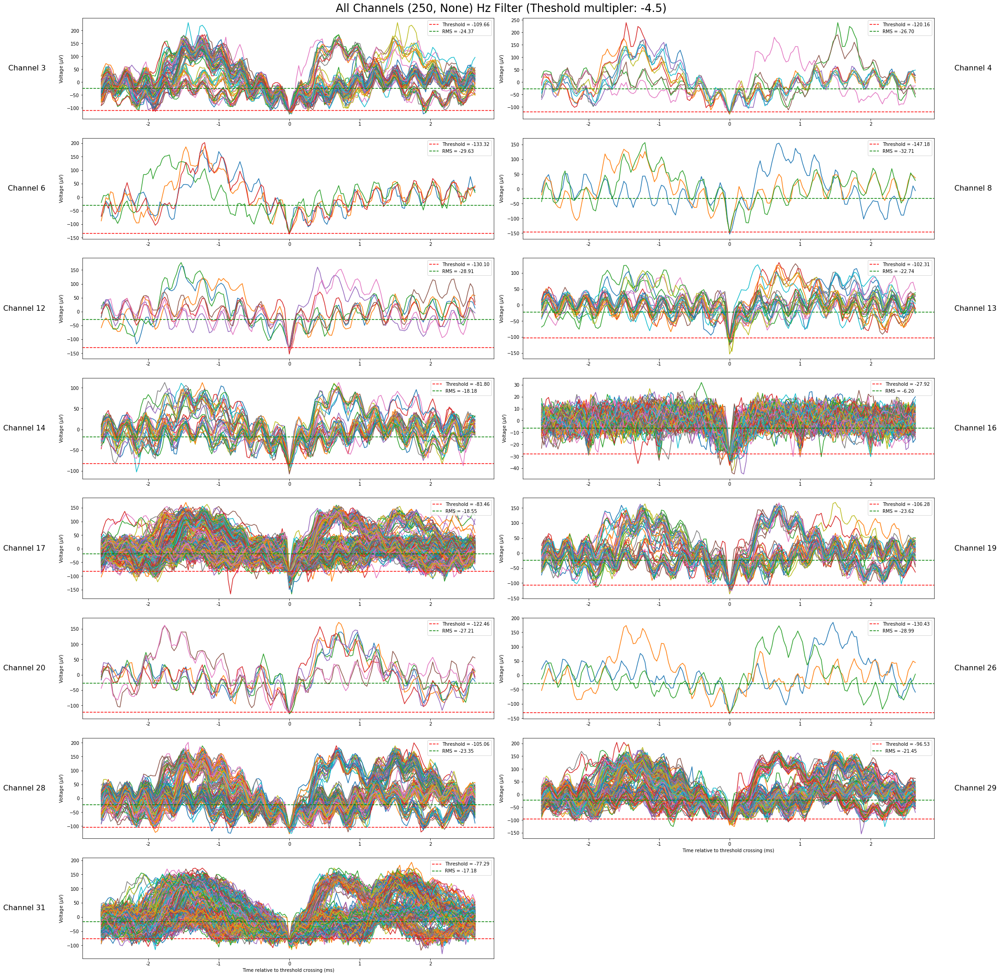

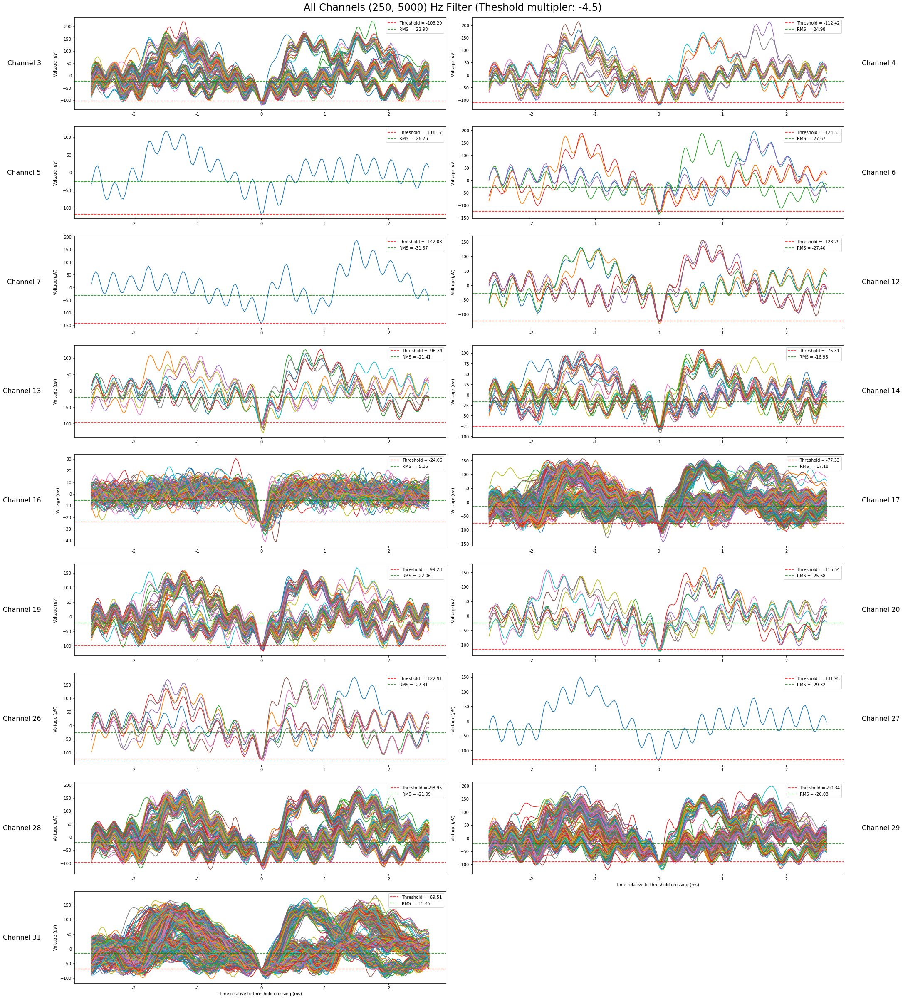

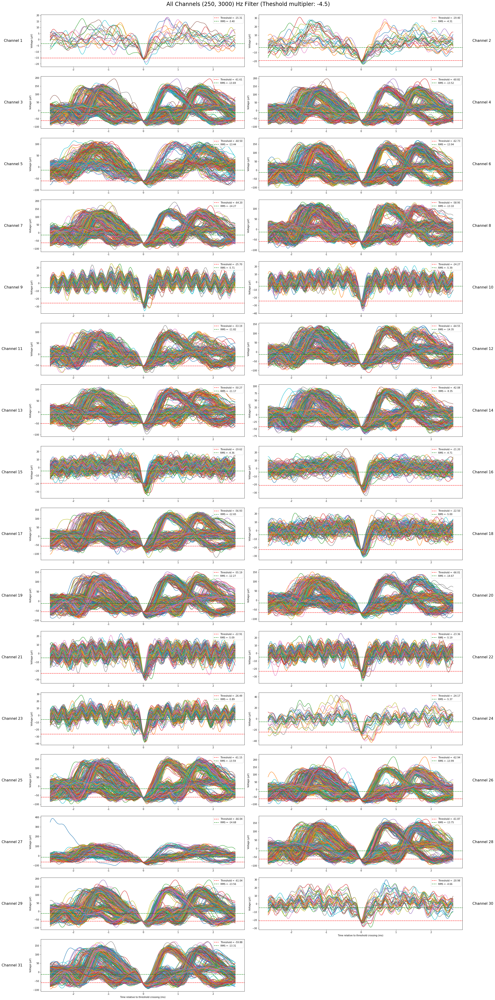

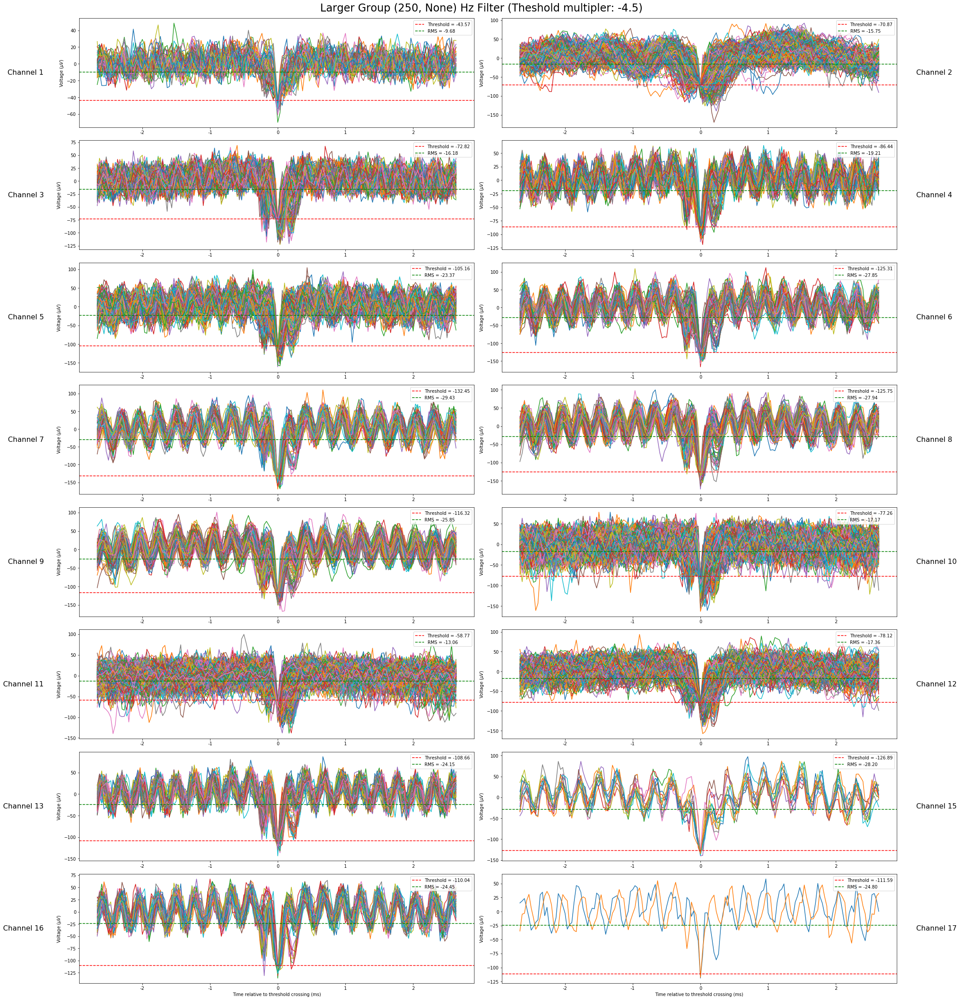

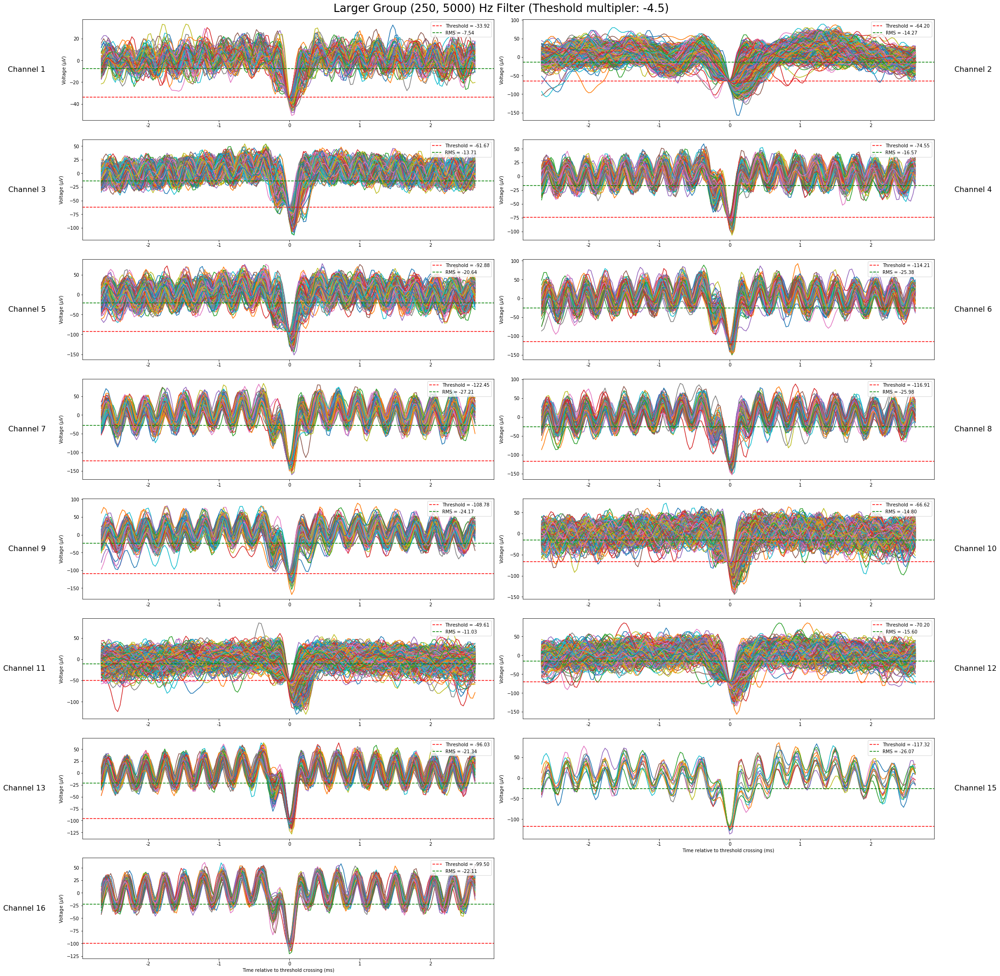

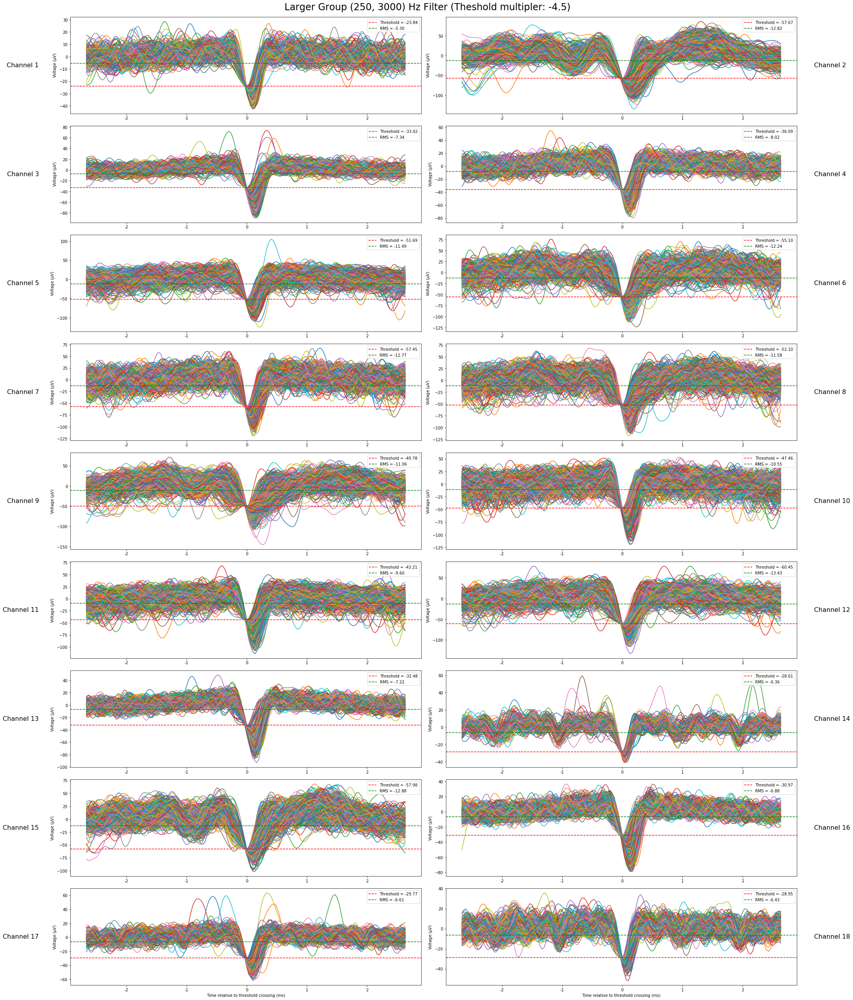

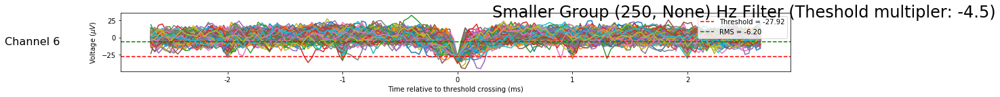

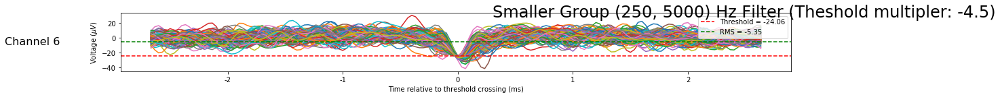

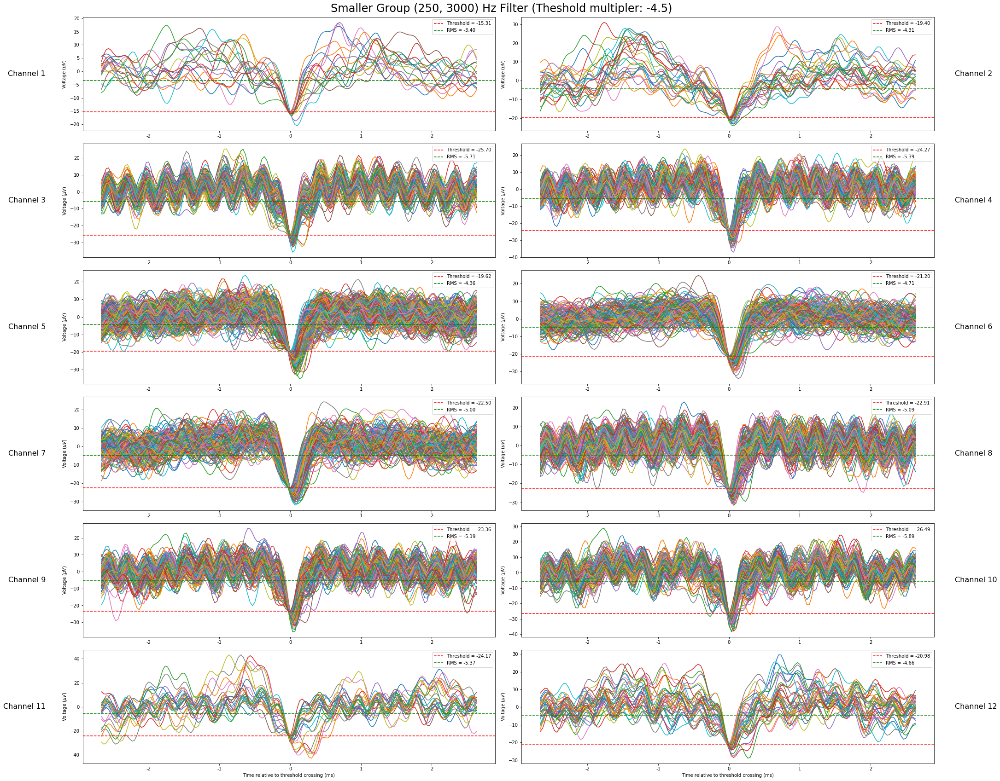

In [21]:
# Plot the spike waveforms
for group_idx, group_name in enumerate(['All Channels', 'Larger Group', 'Smaller Group']):
    for filt_idx, filt_range in enumerate(filter_ranges):
        plot_crossings(crossings[group_idx][filt_idx], 
                       threshold_values[group_idx][filt_idx], 
                       filt_data[group_idx][filt_idx], 
                       f'{group_name} {filt_range} Hz Filter (Theshold multipler: {THRESH_MULT})', 
                       pos=False)